# Worksheet 07

Name: Youxuan Ma

UID: U23330522

### Topics

- Density-Based Clustering

### Density-Based Clustering

Follow along with the live coding of the DBScan algorithm.

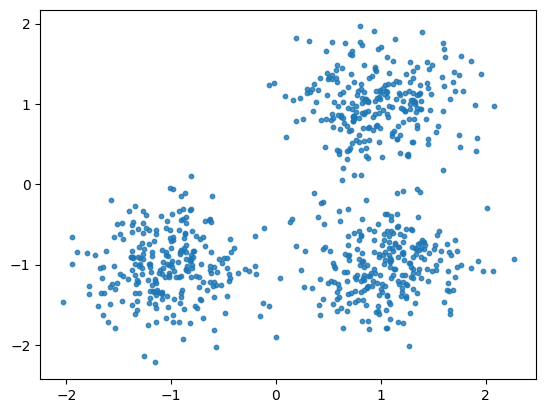

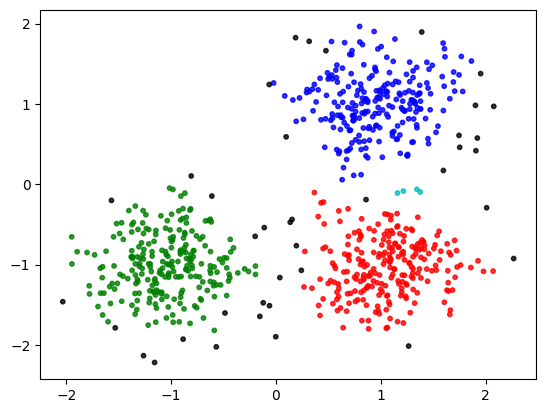

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

centers = [[1, 1], [-1, -1], [1, -1]]
X, _ = datasets.make_blobs(n_samples=750, centers=centers, cluster_std=0.4,
                            random_state=0)
plt.scatter(X[:,0],X[:,1],s=10, alpha=0.8)
plt.show()

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [-1 for _ in range(len(self.dataset))]

    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])
    
    def is_unassigned(self, i):
        return self.assignments[i] == -1

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts
        # neighborhood = 0
        # for j in range(len(self.dataset)):
        #     if i != j and self.distance(i, j) <= self.epsilon:
        #         neighborhood += 1
        # return neighborhood >= self.min_pts
    
    def get_unassigned_neighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return [x for x in neighborhood if self.is_unassigned(x)]
    
    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if i != j and self.distance(i, j) <= self.epsilon:
                neighborhood.append(j)
        return neighborhood
    
    def make_cluster(self, i, cluster_num):
        self.assignments[i] = cluster_num
        neighborhood_queue = self.get_unassigned_neighborhood(i)
        while neighborhood_queue:
            next = neighborhood_queue.pop()
            if self.assignments[next] != -1:
                continue
            
            self.assignments[next] = cluster_num

            if self.is_core(next):
                neighborhood_queue += self.get_unassigned_neighborhood(next)
        
        return

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        cluster_num = 0
        for i in range(len(self.dataset)):
            if self.assignments[i] != -1:
                continue
            if self.is_core(i):
                self.make_cluster(i, cluster_num)
            cluster_num += 1
        return self.assignments

clustering = DBC(X, 3, .2).dbscan()
colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 20)
plt.scatter(X[:, 0], X[:, 1], color=colors[clustering].tolist(), s=10, alpha=0.8)
plt.show()

## Challenge Problem

Using the code above and the template provided below, create the animation below of the DBScan algorithm.

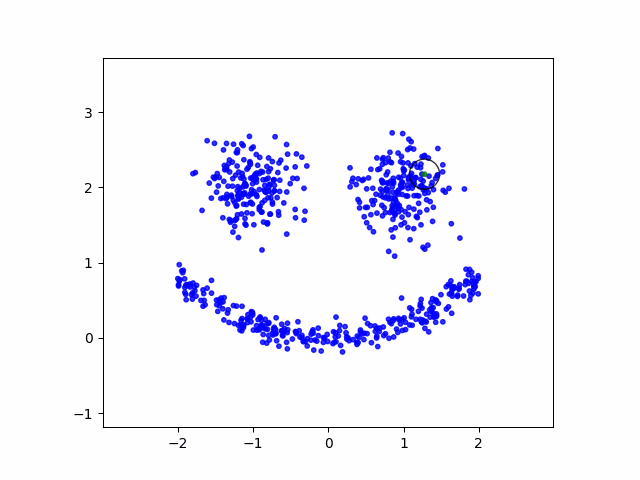

In [10]:
from IPython.display import Image
Image(filename="dbscan_2.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs

Below is the animation of the dataset used in class.

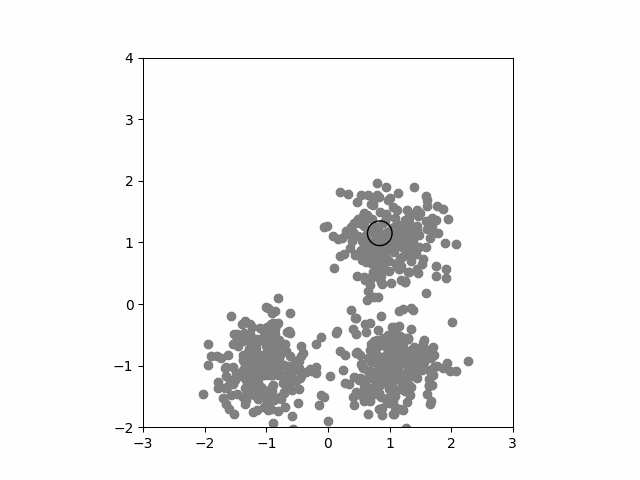

In [11]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from IPython.display import Image

TEMPFILE = 'temp0.png'

centers = [[1, 1], [-1, -1], [1, -1]]
X, _ = datasets.make_blobs(n_samples=750, centers=centers, cluster_std=0.4,
                            random_state=0)


class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [-1 for _ in range(len(self.dataset))]
        self.snaps = []
        self.last_assigned = 0

    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])
    
    def is_unassigned(self, i):
        return self.assignments[i] == -1

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts
        
    def get_unassigned_neighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return [x for x in neighborhood if self.is_unassigned(x)]
    
    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if i != j and self.distance(i, j) <= self.epsilon:
                neighborhood.append(j)
        return neighborhood
    
    def make_cluster(self, i, cluster_num):
        self.assignments[i] = cluster_num
        self.last_assigned = i
        self.snapshot()
        neighborhood_queue = self.get_unassigned_neighborhood(i)
        while neighborhood_queue:
            next = neighborhood_queue.pop()
            if self.assignments[next] != -1:
                continue
            
            self.assignments[next] = cluster_num
            self.last_assigned = next
            self.snapshot()

            if self.is_core(next):
                neighborhood_queue += self.get_unassigned_neighborhood(next)
        
        return

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        cluster_num = 0
        for i in range(len(self.dataset)):
            if self.assignments[i] != -1:
                continue
            if self.is_core(i):
                self.make_cluster(i, cluster_num)
            cluster_num += 1
        return self.assignments
    
    def snapshot(self):
        fig, ax = plt.subplots()
        colors = ['red', 'green', 'blue', 'yellow']
        for point, assignment in zip(self.dataset, self.assignments):
            color = 'grey' if assignment == -1 else colors[assignment % len(colors)]
            ax.scatter(point[0], point[1], c=color)
        
        # Create a circle around the point that was last assigned to a cluster
        # Assuming self.last_assigned is set to the index of the point that was last assigned
        cir = plt.Circle((self.dataset[self.last_assigned][0], self.dataset[self.last_assigned][1]), 
                         self.epsilon, color='black', fill=False)
        ax.add_patch(cir)
        
        ax.set_xlim(-3, 3)
        ax.set_ylim(-2, 4)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close(fig)

        img = im.fromarray(np.asarray(im.open(TEMPFILE)))
        self.snaps.append(img)
        return img

dbc = DBC(X, 3, .2)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan0.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

Image(filename="dbscan0.gif", width=500, height=500)

Below is the animation for the dataset of the Challenge Problem.

In [12]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [-1 for _ in range(len(self.dataset))]
        self.snaps = []
        self.last_assigned = 0

    def distance(self, i, j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])
    
    def is_unassigned(self, i):
        return self.assignments[i] == -1

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts
        
    def get_unassigned_neighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return [x for x in neighborhood if self.is_unassigned(x)]
    
    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if i != j and self.distance(i, j) <= self.epsilon:
                neighborhood.append(j)
        return neighborhood
    
    def make_cluster(self, i, cluster_num):
        self.assignments[i] = cluster_num
        self.last_assigned = i
        self.snapshot()
        neighborhood_queue = self.get_unassigned_neighborhood(i)
        while neighborhood_queue:
            next = neighborhood_queue.pop()
            if self.assignments[next] != -1:
                continue
            
            self.assignments[next] = cluster_num
            self.last_assigned = next
            self.snapshot()

            if self.is_core(next):
                neighborhood_queue += self.get_unassigned_neighborhood(next)
        
        return

    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        cluster_num = 0
        for i in range(len(self.dataset)):
            if self.assignments[i] != -1:
                continue
            if self.is_core(i):
                self.make_cluster(i, cluster_num)
            cluster_num += 1
        return self.assignments
    
    def snapshot(self):
        fig, ax = plt.subplots()
        colors = ['red', 'green', 'blue', 'yellow']
        for point, assignment in zip(self.dataset, self.assignments):
            color = 'grey' if assignment == -1 else colors[assignment % len(colors)]
            ax.scatter(point[0], point[1], c=color)
        
        cir = plt.Circle((self.dataset[self.last_assigned][0], self.dataset[self.last_assigned][1]), 
                         self.epsilon, color='black', fill=False)
        ax.add_patch(cir)
        
        ax.set_xlim(-3, 3)
        ax.set_ylim(-2, 4)
        ax.set_aspect('equal')

        fig.savefig(TEMPFILE)
        plt.close(fig)

        img = im.fromarray(np.asarray(im.open(TEMPFILE)))
        self.snaps.append(img)
        return img


num_samples = 300
centers = [[-1, 2], [1, 2]]
eyes, _ = datasets.make_blobs(n_samples=num_samples, centers=centers, cluster_std=0.2)

mouth_x = np.linspace(-1.5, 1.5, int(num_samples / 3))
mouth_y = 0.2 * mouth_x**2 + 0.02 * np.random.randn(mouth_x.shape[0])

face = np.vstack((eyes, np.column_stack((mouth_x, mouth_y))))

min_pts = 4
epsilon = 0.3
dbc = DBC(face, min_pts, epsilon)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

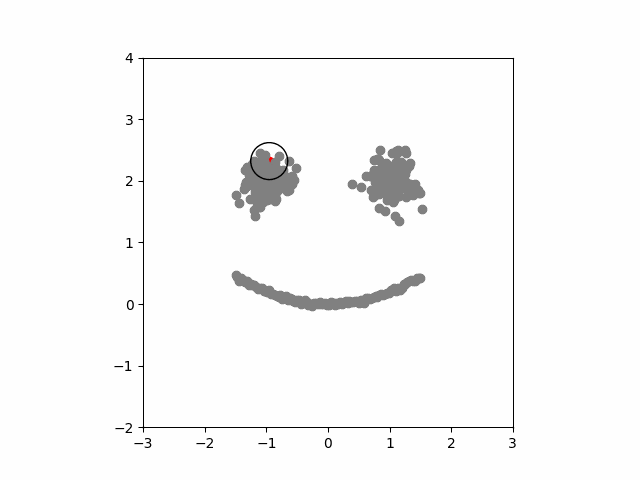

In [13]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)